### Generic Imports

In [2]:
#import scipy.signal
print('Start')
from IPython.display import Audio, display
import numpy as np
import tqdm
import matplotlib.pyplot as plt
#from matplotlib import gridspec
import warnings
import random
import sklearn.preprocessing
import norbert
import musdb
import torch
import os
import pickle 

warnings.simplefilter(action='ignore', category=FutureWarning)

%load_ext autoreload
%autoreload 2

from dataloader_slakh import SlakhDataset

Start


/home/nicolas/workspace/ma/ma4/ddspzart/.venv/lib/python3.8/site-packages/requests/__init__.py:102: RequestsDependencyWarning: urllib3 (1.26.4) or chardet (5.0.0)/charset_normalizer (2.0.7) doesn't match a supported version!
  warnings.warn("urllib3 ({}) or chardet ({})/charset_normalizer ({}) doesn't match a supported "


Initialize the dataset

In [3]:
if os.path.abspath(os.getcwd()) == '/home/olaf/Documents/GitHub/ddspzart/workspace_2/open-unmix-pytorch':
    %cd ../source_separation/
%pwd
                
train_dataset = SlakhDataset(seq_duration=5.0)

FileNotFoundError: [Errno 2] No such file or directory: 'C:/Users/User/Documents/GitHub/uni/ddspzart/workspace_2/source_separation/data/OneExampleRecording/train'

In [ ]:
train_dataset.target = "Trumpet"
train_dataset.filter_target()


print(len(train_dataset))

x = train_dataset.targets[5].get_total_audio()
display(Audio(x, rate=44100))

80


In [ ]:
validation_dataset = SlakhDataset(split='validation',seq_duration=5.0)
validation_dataset.target = "Trumpet"
validation_dataset.filter_target()

  0%|          | 0/270 [00:00<?, ?it/s]

In [ ]:
# Testing
test_dataset = SlakhDataset(split='test',seq_duration=5.0)
test_dataset.target = "Trumpet"
test_dataset.filter_target()


  0%|          | 0/151 [00:00<?, ?it/s]

In [ ]:
%cd ../open-unmix-pytorch/
%pwd

/home/olaf/Documents/GitHub/ddspzart/workspace_2/open-unmix-pytorch


'/home/olaf/Documents/GitHub/ddspzart/workspace_2/open-unmix-pytorch'

## Compute global mean and scale of Dataset

Sample from the dataset and update mean standard deviation using scikit-learn `StandardScaler`.

In [ ]:
import openunmix
import torch.nn as nn
stft = openunmix.transforms.TorchSTFT() 
spec = openunmix.transforms.ComplexNorm(mono=True)
transform = nn.Sequential(stft, spec)

scaler = sklearn.preprocessing.StandardScaler()

for x, y in tqdm.notebook.tqdm(train_dataset):
    X = transform(x[None]).T
    scaler.partial_fit(X.squeeze().numpy())
print(X.shape, X.T.shape)

# set inital input scaler values
scale = np.maximum(
    scaler.scale_,
    1e-4*np.max(scaler.scale_)
)
mean = scaler.mean_

  0%|          | 0/80 [00:00<?, ?it/s]

/home/olaf/Documents/GitHub/ddspzart/workspace_2/.openunmix_venv/lib/python3.7/site-packages/ipykernel_launcher.py:10: UserWarning: The use of `x.T` on tensors of dimension other than 2 to reverse their shape is deprecated and it will throw an error in a future release. Consider `x.mT` to transpose batches of matricesor `x.permute(*torch.arange(x.ndim - 1, -1, -1))` to reverse the dimensions of a tensor. (Triggered internally at  ../aten/src/ATen/native/TensorShape.cpp:2318.)
  # Remove the CWD from sys.path while we load stuff.


torch.Size([212, 2049, 1, 1]) torch.Size([1, 1, 2049, 212])


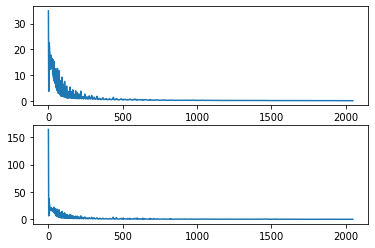

In [ ]:
f, axes = plt.subplots(2, 1)
axes[0].plot(mean)
axes[1].plot(scale)

## Set up the model

In [ ]:
import pytorch_lightning as pl
import trainer_open_unmix
import time
custom_model = trainer_open_unmix.SourceSeparation(mean, scale)
model = trainer_open_unmix.SourceSeperationLight(custom_model)

validation_sampler = torch.utils.data.DataLoader(validation_dataset, batch_size=8, shuffle=False, num_workers=4)
train_sampler = torch.utils.data.DataLoader(train_dataset, batch_size=8, shuffle=True, num_workers=4)
test_sampler = torch.utils.data.DataLoader(test_dataset, batch_size=8, shuffle=False, num_workers=4)

trainer = pl.Trainer(max_epochs=5,check_val_every_n_epoch=2,default_root_dir="/home/olaf/Documents/GitHub/ddspzart/workspace_2/source_separation")

tic = time.perf_counter()
tic2 = time.process_time()
trainer.fit(model=model, train_dataloaders=train_sampler, val_dataloaders=validation_sampler)
toc = time.perf_counter()
toc2 = time.process_time()
print('Next', toc - tic, toc2-tic2)

INFO: GPU available: True, used: False
INFO: TPU available: False, using: 0 TPU cores
INFO: IPU available: False, using: 0 IPUs
INFO: HPU available: False, using: 0 HPUs
INFO: 
  | Name | Type | Params
------------------------------
------------------------------
0         Trainable params
0         Non-trainable params
0         Total params
0.000     Total estimated model params size (MB)


Sanity Checking: 0it [00:00, ?it/s]

Training: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Validation: 0it [00:00, ?it/s]

Next 117.56072497600053 324.3853826320001


In [ ]:
trainer.test(model=model, dataloaders=test_sampler)

Testing: 0it [00:00, ?it/s]

INFO: Set stem_audio to zero.
INFO: Set stem_audio to zero.
INFO: Set stem_audio to zero.
INFO: Set stem_audio to zero.
INFO: Set stem_audio to zero.
INFO: Set stem_audio to zero.
INFO: Set stem_audio to zero.
INFO: Set stem_audio to zero.
INFO: Set stem_audio to zero.
INFO: Set stem_audio to zero.


────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
       Test metric             DataLoader 0
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────
        test_loss           1.0287461280822754
────────────────────────────────────────────────────────────────────────────────────────────────────────────────────────


[{'test_loss': 1.0287461280822754}]

In [ ]:
%pwd
CKPT_PATH = f"../source_separation/data/checkpoints/exp4_trumpet_v2.pt"

trainer.save_checkpoint(CKPT_PATH)
#new_model = MyLightningModule.load_from_checkpoint(checkpoint_path="example.ckpt")

In [ ]:
trainer.model.model.unmix

OpenUnmix(
  (fc1): Linear(in_features=512, out_features=512, bias=False)
  (bn1): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (lstm): LSTM(512, 256, num_layers=3, dropout=0.4, bidirectional=True)
  (fc2): Linear(in_features=1024, out_features=512, bias=False)
  (bn2): BatchNorm1d(512, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
  (fc3): Linear(in_features=512, out_features=2049, bias=False)
  (bn3): BatchNorm1d(2049, eps=1e-05, momentum=0.1, affine=True, track_running_stats=True)
)

In [ ]:
# separate with customly trained models
track = train_dataset[0]

device = "cpu"

unmix = trainer.model.model.unmix

print(track[0][None,...].shape)
audio_torch = track[0][None,...].float().to(device)
print(audio_torch)
target_models = {"French horn": unmix}
own_separator = openunmix.model.Separator(target_models,nb_channels=1).to(device)
#y = torch.tensor(track[1][None,...]).float().to(device).clone().detach().squeeze()
y = track[1][None,...].float().to(device).squeeze()
print(y)
y_hat = own_separator.forward(audio_torch).clone().detach().squeeze()
print(y_hat)
display(Audio(track[0], rate=44100))
display(Audio(y.cpu().numpy(), rate=44100))
display(Audio(y_hat.cpu().numpy(), rate=44100))

print(torch.mean((y-y_hat)**2))

torch.Size([1, 1, 220500])
tensor([[[ 0.0059,  0.0040,  0.0039,  ..., -0.0940, -0.0926, -0.0925]]])
tensor([ 6.6833e-03,  7.6599e-03,  8.8196e-03,  ..., -3.0518e-05,
         6.4087e-04,  1.7090e-03])
tensor([-0.0269, -0.0288, -0.0300,  ...,  0.0028,  0.0034,  0.0035])


tensor(0.0012)


In [ ]:
# Evaluation
import museval

global_rate = 44_100
win = 1.0; hop = 1.0; mode='v4'
y_np = y.cpu().numpy()
y_hat_np = y_hat.cpu().numpy()
reference = np.reshape(y_np,(1,len(y),1))
estimates = np.reshape(y_hat_np,(1,len(y),1))

print(reference.shape,estimates.shape)

metrics = museval.evaluate(reference,estimates, 
                        win=int(win*global_rate),hop=int(hop*global_rate),mode=mode)

metrics = [np.mean(m) for m in metrics]
print(metrics)
SDR, ISR, SIR, SAR = metrics

(1, 220500, 1) (1, 220500, 1)
[-1.5332652571815573, 3.6639603758898396, inf, -6.760095354733534]
